# Process topography

This notebook processes the stitched Charrassin bathymetry and produces cleaned topography, mask files and ice thickness files.

This notebook requires that you have alreadu run `Generate-Charrassin-bathy.ipynb`, and have the output files from that. To summarise that notebook (modified from Ezhil), it loads the Charrassin data (link in notebook) in its Antarctic centred coordinates and geotiff, and turns them into latlon netcdf. Then creates regrdding weights (requires a large mem interactive job). Then regrids the various data files onto the 8km model grid made by Angus and then saves the output. The topography version also stitches to the existing GEBCO.

In this notebook we use those outputs to make consistent masks and some cleaning up. This is done here in a notebook since the OM3 gen_topo doesn't work for this application out of the box.

#### gen_topo pipeline

Doesn't work with assumption of land = elevation > 0m

But we still want to follow some of the steps in https://github.com/ACCESS-NRI/make_OM3_025deg_topo/blob/main/gen_topo.sh

https://github.com/COSIMA/bathymetry-tools/blob/a298d5198540c529b703fd82b216f4073ea4af0a/src/topography.f90
`

### to do list for claire

-  [x] document this nb
-  [x] assess importance of deseas and check any islands, weird stuff at coast lines FOR NO ICE SHELF - definitely some inland seas.
-  [x] make topog, ocean_mask, kmt files using same metadata, file type etc as original FOR NO ICE SHELF
-  [x] crop files from global to pan-antarctic FOR NO ICE SHELF
-  [x] create nuopc mesh files (same process as previously) FOR NO ICE SHELF

add ice shelf cavities:

-  [x] make topog, ocean_mask, kmt files using same metadata, file type etc as original FOR ice shelf.
-  [x] Plus, ice thickness and ice area file.
-  [x] crop files from global to pan-antarctic
-  [x] create nuopc mesh files (same process as previously)
-  [x] assess importance of deseas and check any islands, weird stuff at coast lines
-  [ ] check nuopc stuff about what ocean_mask is meant to be
-  [ ] salt restoring mask?

In [1]:
import xesmf
import xarray as xr
import os
import cmocean as cm
import cartopy.crs as ccrs
import cosima_cookbook as cc
from dask.distributed import Client
import dask.array as da
import numpy as np
from osgeo import gdal
import matplotlib.pyplot as plt

from pyproj import Transformer
from pyproj import CRS
ps_to_ll = Transformer.from_crs( "EPSG:3031","EPSG:4326", always_xy=True) 
#

In [2]:
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/33543/status,
Dashboard: /proxy/33543/status,Workers: 7
Total threads: 14,Total memory: 63.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:33619,Workers: 7
Dashboard: /proxy/33543/status,Total threads: 14
Started: Just now,Total memory: 63.00 GiB
Comm: tcp://127.0.0.1:44623,Total threads: 2
Dashboard: /proxy/41011/status,Memory: 9.00 GiB
Nanny: tcp://127.0.0.1:41817,


Load files from `Generate-Charrassin-bathy.ipynb`

In [3]:
topog = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/topog_Charrassin_regridded.nc')
ice_thick = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/ice_thickness_Charrassin_regridded.nc')
surface = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/surface_Charrassin_regridded.nc')
water_height = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/WATER_HEIGHT_Charrassin_regridded.nc')

In [4]:
topog

<xarray.Dataset> Size: 190MB
Dimensions:  (ny: 3672, nx: 4320)
Dimensions without coordinates: ny, nx
Data variables:
    depth    (ny, nx) float32 63MB ...
    lat      (ny, nx) float32 63MB ...
    lon      (ny, nx) float32 63MB ...
Attributes:
    description:  Charrassin 2025 depth regridded onto global 1/12th (8km) gr...

##### Plot parts of ocean with depth > 6000m

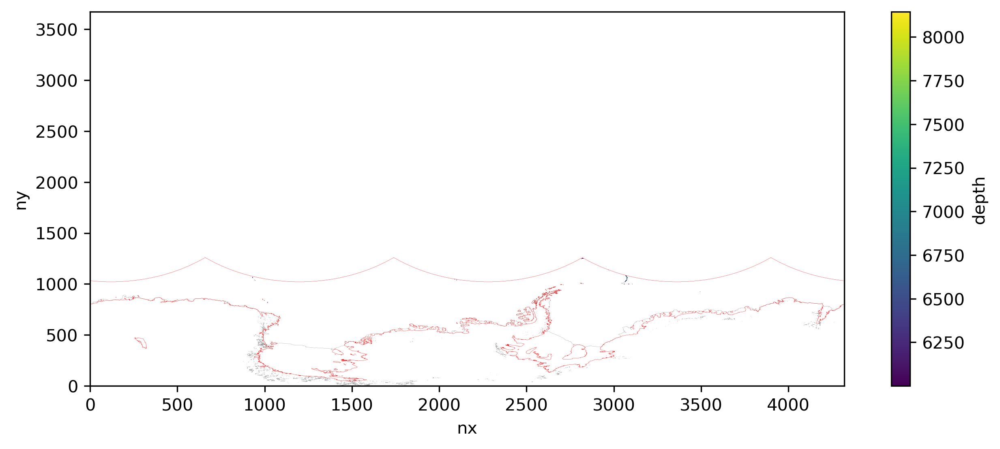

In [5]:
fig = plt.figure(figsize = (10,4),dpi = 300)
topog.depth.where(topog.depth>6000).plot()
(ice_thick.thick.where(ice_thick.thick>0)*0+1).fillna(0).plot.contour(levels = [0.5],colors = 'k', linewidths = 0.04)
(water_height.elevation.where(water_height.elevation>0)*0+1).fillna(0).plot.contour(levels = [0.5],colors = 'r', linewidths = 0.1)

##### Plot depths < 0 (above sea level)

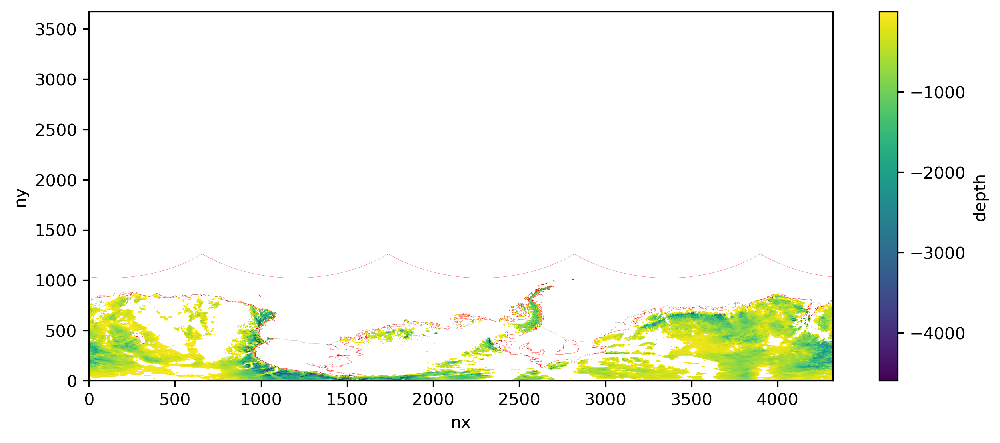

In [6]:
fig = plt.figure(figsize = (10,4),dpi = 300)
topog.depth.where(topog.depth<0).plot()
(ice_thick.thick.where(ice_thick.thick>0)*0+1).fillna(0).plot.contour(levels = [0.5],colors = 'k', linewidths = 0.04)
(water_height.elevation.where(water_height.elevation>0)*0+1).fillna(0).plot.contour(levels = [0.5],colors = 'r', linewidths = 0.1)

# try deseas (not working!!)

./bathymetry-tools/bin/topogtools deseas -i /g/data/x77/cy8964/mom6/input/input-8km/topog_Charrassin_regridded.nc -o /g/data/x77/cy8964/mom6/input/input-8km/topog_Charrassin_regridded_deseas.nc --grid_type C

doesn't work - type topography_t needs to have sea area frac and geolon ertc https://github.com/COSIMA/bathymetry-tools/blob/a298d5198540c529b703fd82b216f4073ea4af0a/src/topography.f90

-> needs fortran to be modified....

-> let's do it manually instead.

# need to apply 6000m depth max on new bathy

(and maybe zero max?)

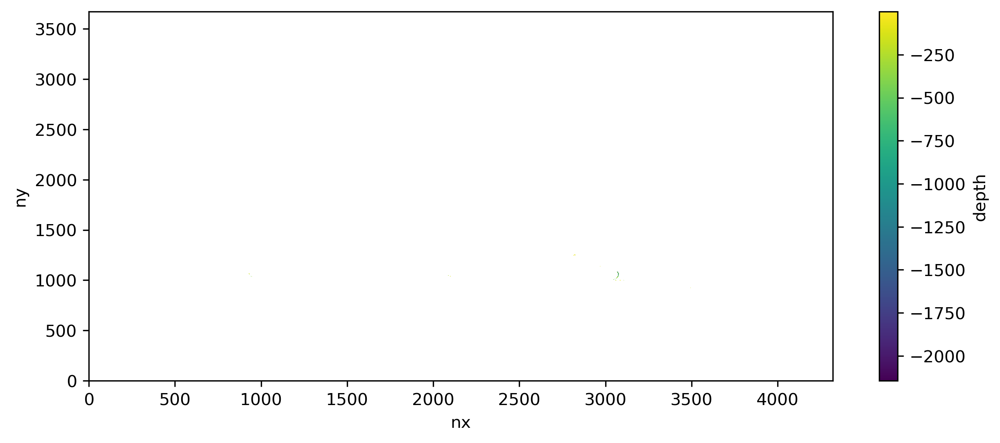

In [7]:
topog_depth_cutoff = topog.copy()
topog_depth_cutoff['depth'] = topog_depth_cutoff.depth.where(topog_depth_cutoff.depth<6000).fillna(6000)
diff = (topog_depth_cutoff.depth - topog.depth)

fig = plt.figure(figsize = (10,4),dpi = 300)
diff.where(diff !=0).plot()

In [8]:
topog_depth_cutoff

<xarray.Dataset> Size: 190MB
Dimensions:  (ny: 3672, nx: 4320)
Dimensions without coordinates: ny, nx
Data variables:
    depth    (ny, nx) float32 63MB 26.02 28.33 30.56 32.58 ... -0.0 -0.0 -0.0
    lat      (ny, nx) float32 63MB ...
    lon      (ny, nx) float32 63MB ...
Attributes:
    description:  Charrassin 2025 depth regridded onto global 1/12th (8km) gr...

topog_depth_cutofftopog now has the bathymetry with max 6km depth.


# masks

Two masks needed

```ocean_mask.nc``` for the whole ocean to indicate where there is land (0) and ocean (1). Use as is for north (depth =< 0m), for GL the MOM6 and Charrassin grounding lines may differ so we move the land mask inland a few steps away so that GL is natural in MOM6. Maybe needs to be revisited.



``kmt.nc`` the sea ice mask, the same north of 60 but for Antarctica where ice sheet edge is (calculated from ice sheet being present and then filling "lakes")

After this, apply ocean_mask to topog.nc to have a consistent topog file with NaNs in the right place

and save in correct format

Also need to rename lat lon to geolon_t,geolat_t

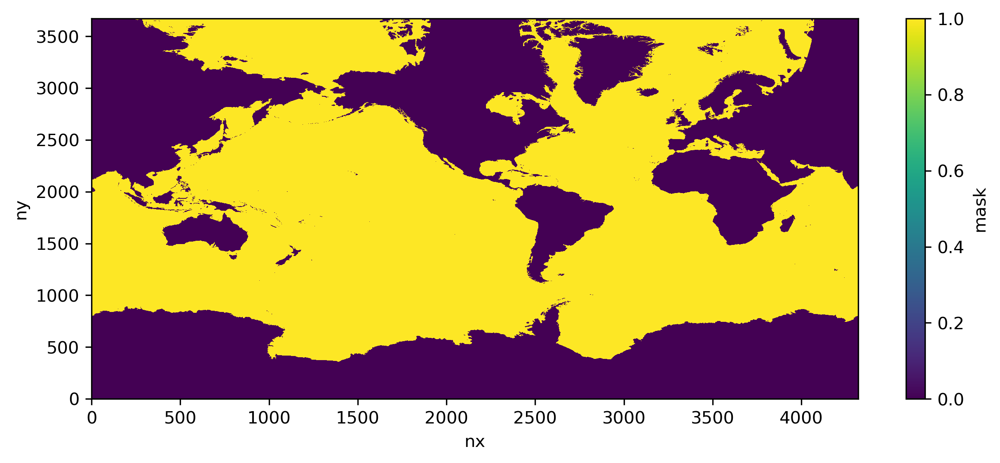

In [9]:
# first sea ice mask, still needs deseas/lake removal

kmt = topog_depth_cutoff.copy()
kmt["mask"] = (kmt.depth.where(kmt.depth > 0)*0+1).fillna(0)
ice_mask = (ice_thick.thick.where(ice_thick.thick==0)*0+1).fillna(0)
kmt["mask"] = np.minimum(kmt["mask"],ice_mask)
kmt = kmt.drop_vars("depth")
kmt = kmt.rename({'lat':'geolat_t','lon':'geolon_t'})

fig = plt.figure(figsize = (10,4),dpi = 300)
kmt.mask.plot()

Iterated method to extend land mask into continent

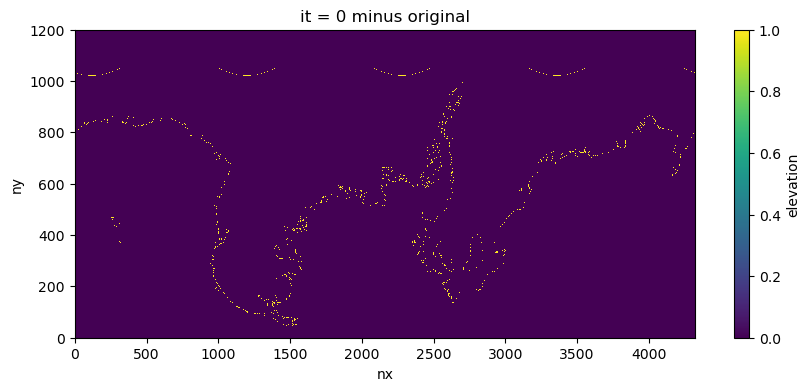

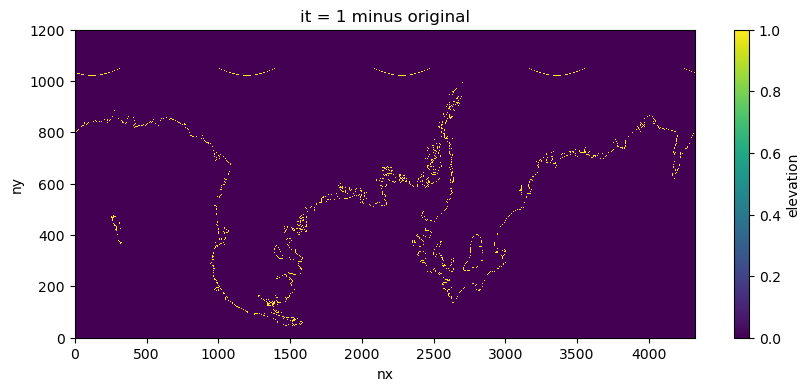

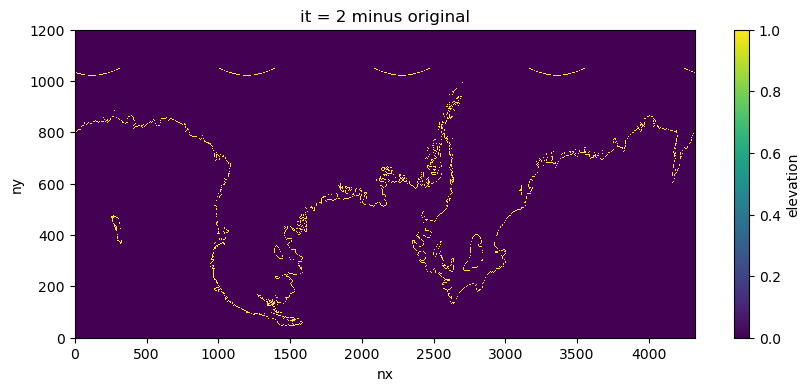

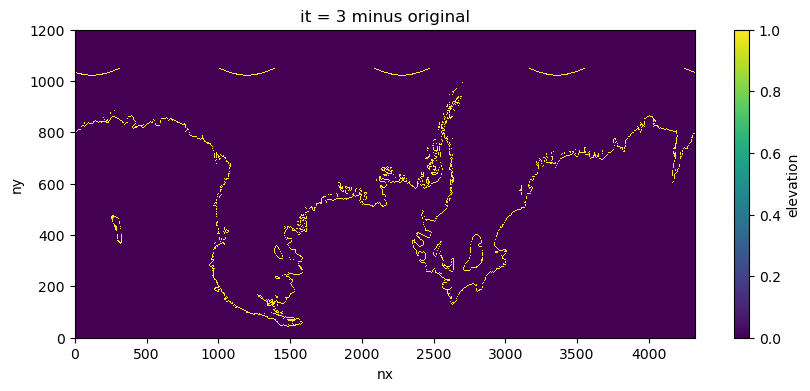

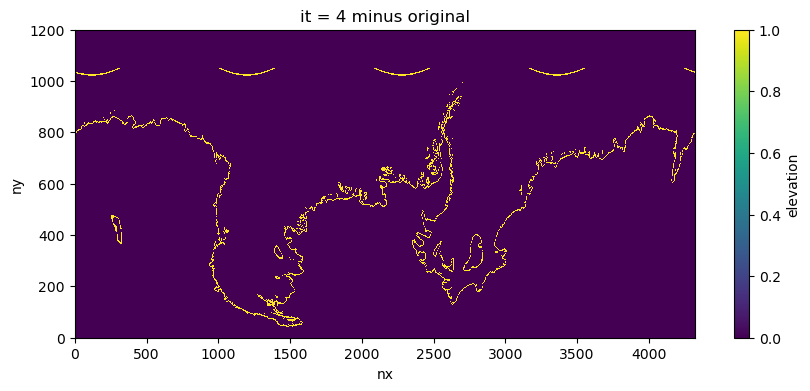

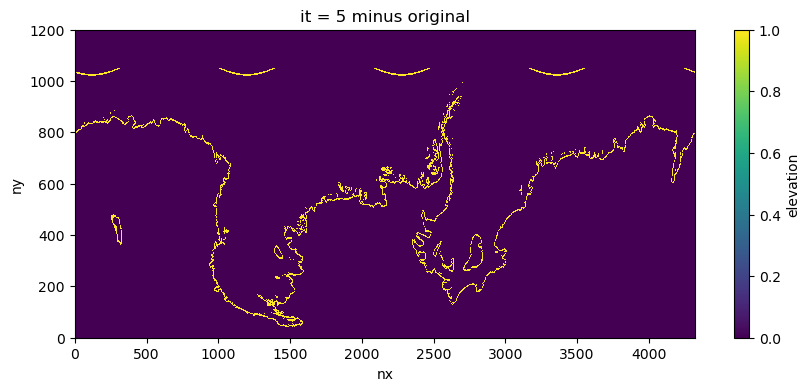

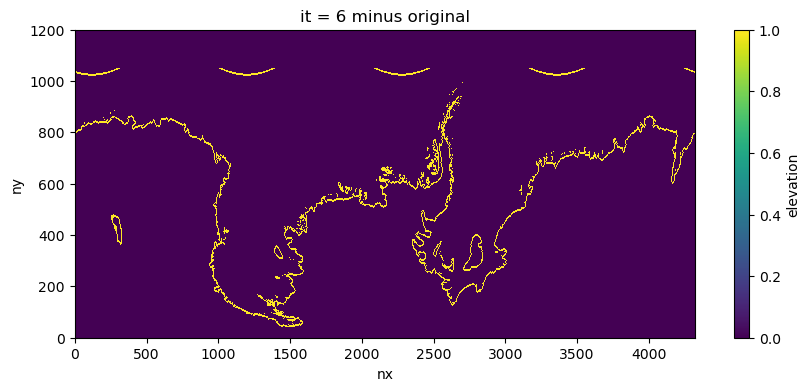

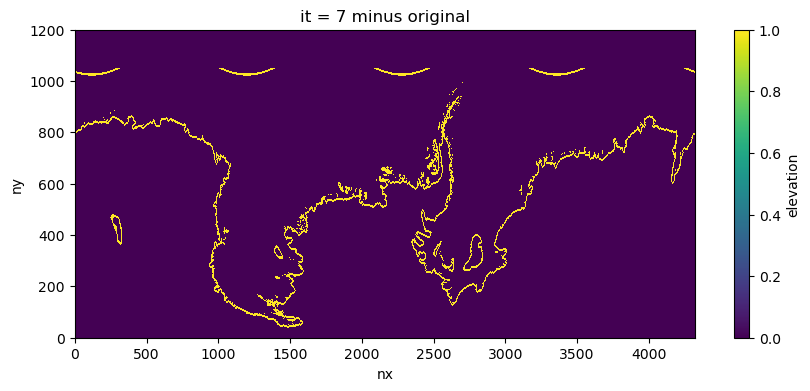

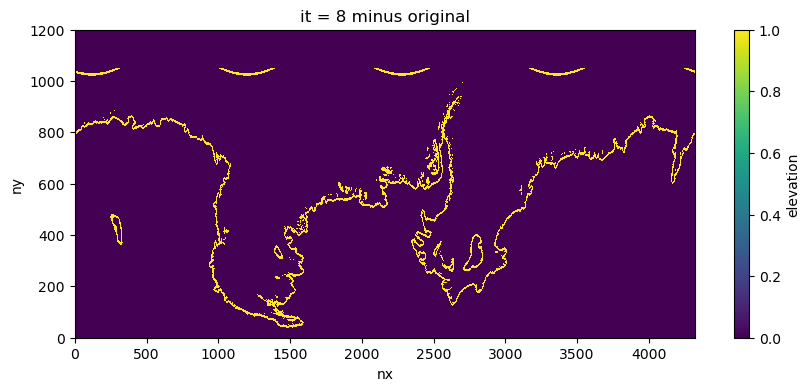

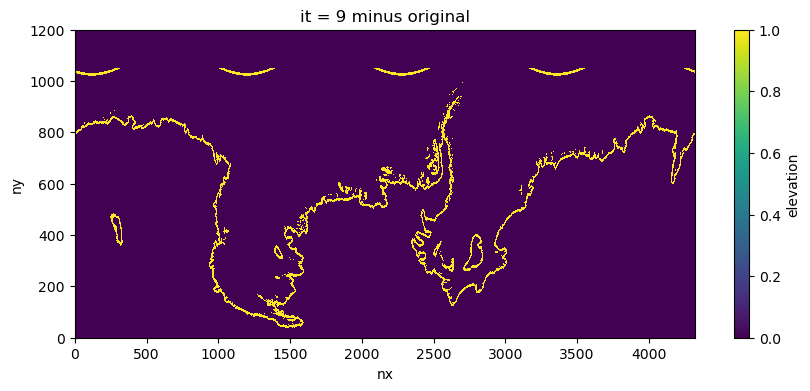

In [10]:
# extend ocena mask into antarctic continent for more natural GL
# since water height may not be the same in the model.
# and MOM6 can deal with GL (or can it....)

draft_ocean_mask = xr.where(water_height.elevation>0,1,0)
draft_ocean_mask_extended = draft_ocean_mask.copy()


# for j in np.arange(1,1050-1): #only antarctica
#     for i in np.arange(1,len(draft_ocean_mask.nx)-1):
#         # find ice points
#         if draft_ocean_mask_extended[j,i] ==0:
#             if ((draft_ocean_mask_extended[j-1,i] ==1) or (draft_ocean_mask_extended[j+1,i] ==1)  or \
#                 (draft_ocean_mask_extended[j,i-1] ==1) or (draft_ocean_mask_extended[j,i+1] ==1)):
#                 # i.e. if neighbouring
#                 # thenmake it ocean
#                 draft_ocean_mask_extended[i,j] = 0

## parallelise with xr.roll

for j in np.arange(10): # repeat 10 times

    rolling = draft_ocean_mask_extended.roll(ny = 1) + draft_ocean_mask_extended.roll(ny = -1) + draft_ocean_mask_extended.roll(nx = -1) + draft_ocean_mask_extended.roll(nx = 1)
    # work out which points neighbour ocean (postitive definite)
    # then turn into extra ocean if point satisfties above
    extra_ocean = 1+draft_ocean_mask_extended.where(draft_ocean_mask_extended == 0).where(rolling > 0).where(rolling.ny < 1050).where(rolling.ny > 6)
    # add to mask
    draft_ocean_mask_extended = extra_ocean.fillna(0)+draft_ocean_mask_extended
    fig = plt.figure(figsize = (10,4))
    (draft_ocean_mask_extended-draft_ocean_mask).plot()
    plt.ylim(0,1200)
    plt.title('it = '+str(j)+' minus original')
    plt.show()
    # plot and iterate


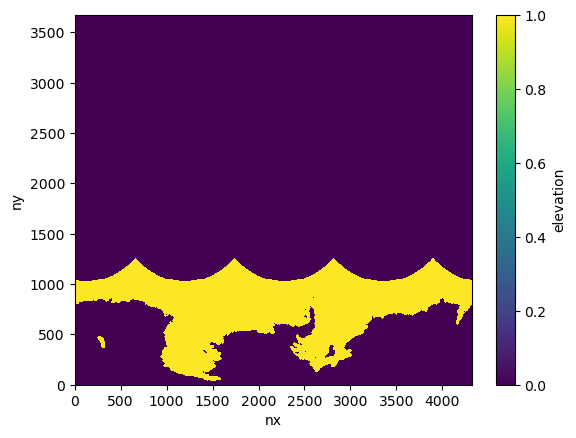

In [11]:
draft_ocean_mask_extended.plot()

#### combine masks together

maybe revisit the curvy lines from northern boudnary of Charrassin data, I don't think it's affecting things but should check.

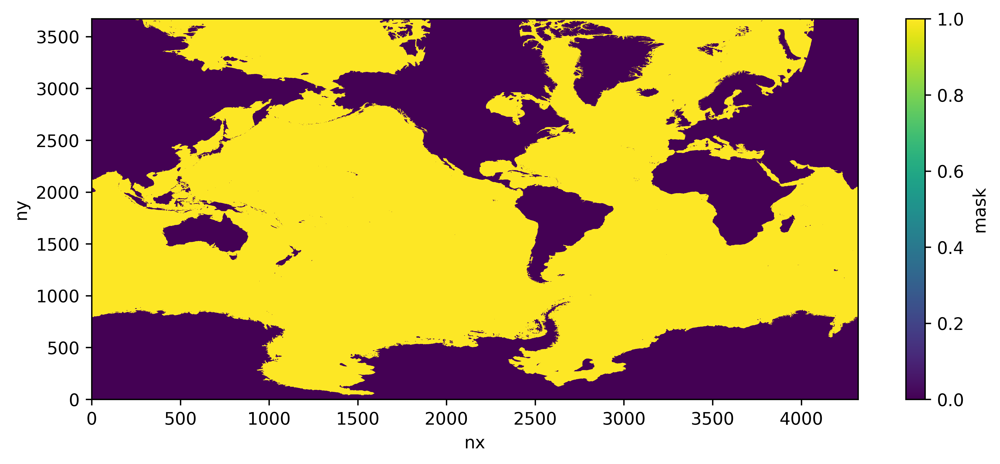

In [23]:
ocean_mask = topog_depth_cutoff.copy()
ocean_mask["mask"] = (ocean_mask.depth.where(ocean_mask.depth > 0)*0+1).fillna(0)

#GL_mask = (water_height.elevation.where(water_height.elevation>0)*0+1).fillna(0)

GL_mask = draft_ocean_mask_extended

##insert spreading south here
N_mask = (GL_mask.where(GL_mask.ny>1000)*0+1).fillna(0)
GL_mask = N_mask+GL_mask
GL_mask = GL_mask.where(GL_mask<=1).fillna(1)
ocean_mask["mask"] = np.minimum(ocean_mask["mask"],GL_mask) 

# fill lake vostok

ocean_mask = ocean_mask.where(((ocean_mask.ny>500) | (ocean_mask.nx>500))).fillna(0)

# drop depth variable

ocean_mask = ocean_mask.drop_vars("depth")

fig = plt.figure(figsize = (10,4),dpi = 600)
ocean_mask.mask.plot()

#### check difference between ocean_mask and kmt

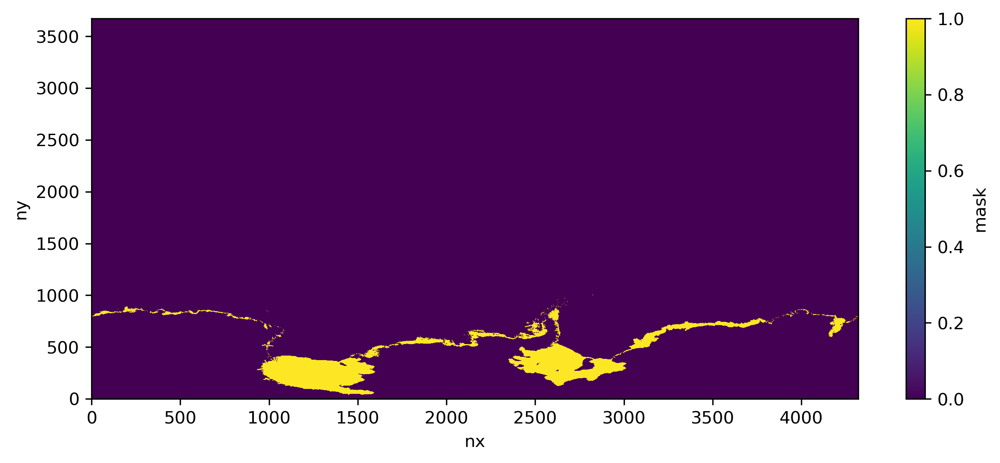

In [24]:
# check difference

fig = plt.figure(figsize = (10,4),dpi = 300)
(ocean_mask.mask - kmt.mask).plot()

#### manually do deseas/lake elimination on ocean_mask

(fill ocean at particular latitude circle through Drake Passage that is all ocean, iterate so that if neighbouring a filled cell and it is ocean it also fills, monitor until converged)

below cell takes ~30 mins, first iteration is slowest and then it speeds up.

(might not be perfect at boundary of E and W if land mask at different latitudes on either side of divide, since array not periodic)

In [25]:
%%time

# manually do deseas on ocean_mask

# we only care about south of 37S, and our chosen latitude cut off is index 1442
small_mask = ocean_mask.mask.isel(ny = np.arange(1442))

#start at left and right side of domain (check it is ocean = value 1)
print(small_mask[-1,0])
print(small_mask[-1,-1])

# document a variable to say I've already checked this point
working_out_mask = np.zeros_like(small_mask)
working_out_mask[-1,0] = 1
working_out_mask[-1,1] = 1
working_out_mask[-2,0] = 1
working_out_mask[-2,1] = 1

# filled mask which is 1 if ocena and connected to say I've already checked this point
filled_mask = np.zeros_like(small_mask)
filled_mask[-1,0] = 1
filled_mask[-1,1] = 1
filled_mask[-2,0] = 1
filled_mask[-2,1] = 1

#also start a line in the middle to speed it up
filled_mask[1050,:] = 1
working_out_mask[1050,:] = 1
#check this latitude circle is all ocean (it is if print statement is 1)
print(np.min(small_mask[1050,:]))

#reset counter of number of working_out_mask cells
sum_ocean = 0

for i in np.arange(35):
    print('iteration ',i)
    # work north-east, and north-west, north of ocean line
    # then work south-east, and south-west, south of ocean line
    
    for jjs in np.arange(1050,1441):
        for iis in np.arange(1,4319):
            if working_out_mask[jjs,iis] == 0:
                # if neighbouring existing is filled mask
                if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1) or (filled_mask[jjs,iis+1] ==1):
                    filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                    #print('yooo')
                # update to say it has been checked
                    working_out_mask[jjs,iis] = 1
        # do boundaries individually for indexing reasons
        iis = 0
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis+1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
        iis = 4319
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
        
    for jjs in np.arange(1050,1441):
        for iis in np.arange(4318,0,-1):
            if working_out_mask[jjs,iis] == 0:
                # if neighbouring existing is filled mask
                if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1) or (filled_mask[jjs,iis+1] ==1):
                    filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                    #print('yooo')
                # update to say it has been checked
                    working_out_mask[jjs,iis] = 1
        iis = 0
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis+1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
        iis = 4319
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
    # now do top
    jjs = 1441
    for iis in np.arange(1,4319):
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1)  or (filled_mask[jjs,iis-1] ==1) or (filled_mask[jjs,iis+1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
    iis = 0
    if working_out_mask[jjs,iis] == 0:
        # if neighbouring existing is filled mask
        if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis+1] ==1):
            filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
            #print('yooo')
        # update to say it has been checked
            working_out_mask[jjs,iis] = 1
    iis = 4319
    if working_out_mask[jjs,iis] == 0:
        # if neighbouring existing is filled mask
        if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1):
            filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
            #print('yooo')
        # update to say it has been checked
            working_out_mask[jjs,iis] = 1
            
    # then work south-east, and south-west, south of ocean line

    for jjs in np.arange(1049,1,-1):
        for iis in np.arange(1,4319):
            if working_out_mask[jjs,iis] == 0:
                # if neighbouring existing is filled mask
                if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1) or (filled_mask[jjs,iis+1] ==1):
                    filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                    #print('yooo')
                # update to say it has been checked
                    working_out_mask[jjs,iis] = 1
        iis = 0
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis+1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
        iis = 4319
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
    for jjs in np.arange(1049,1,-1):
        for iis in np.arange(4318,0,-1):
            if working_out_mask[jjs,iis] == 0:
                # if neighbouring existing is filled mask
                if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1) or (filled_mask[jjs,iis+1] ==1):
                    filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                    #print('yooo')
                # update to say it has been checked
                    working_out_mask[jjs,iis] = 1
        iis = 0
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis+1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
        iis = 4319
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
                    
    print(np.sum(working_out_mask)) # if this number is constant then have converged (no more connected cells)

    if (np.sum(working_out_mask) == sum_ocean):
        print('convergence achieved yay')
        break
    else:
        sum_ocean = np.sum(working_out_mask)

<xarray.DataArray 'mask' ()> Size: 8B
array(1.)
<xarray.DataArray 'mask' ()> Size: 8B
array(1.)
<xarray.DataArray 'mask' ()> Size: 8B
array(1.)
iteration  0
3755264.0
iteration  1
3759871.0
iteration  2
3761677.0
iteration  3
3762819.0
iteration  4
3763570.0
iteration  5
3764133.0
iteration  6
3764591.0
iteration  7
3764938.0
iteration  8
3765245.0
iteration  9
3765494.0
iteration  10
3765704.0
iteration  11
3765881.0
iteration  12
3766031.0
iteration  13
3766142.0
iteration  14
3766226.0
iteration  15
3766292.0
iteration  16
3766346.0
iteration  17
3766392.0
iteration  18
3766430.0
iteration  19
3766460.0
iteration  20
3766482.0
iteration  21
3766496.0
iteration  22
3766500.0
iteration  23
3766500.0
convergence achieved yay
CPU times: user 10min 56s, sys: 9.21 s, total: 11min 5s
Wall time: 10min 57s


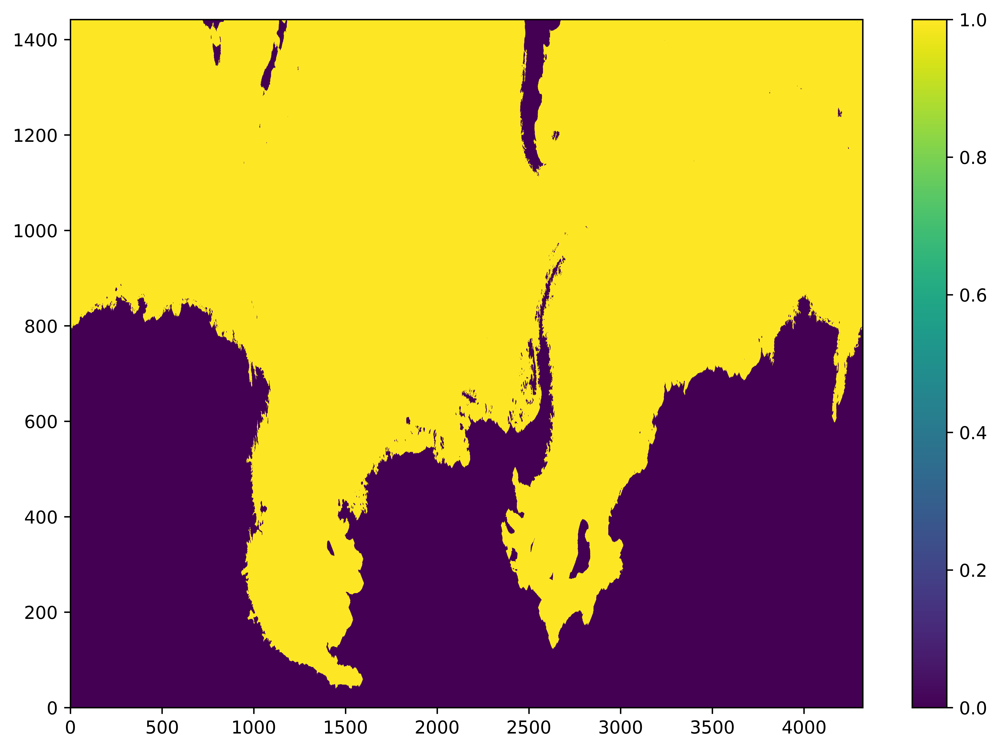

In [26]:
#check 

fig = plt.figure(figsize = (10,7),dpi = 1000)

plt.pcolormesh(filled_mask)
plt.colorbar()

# Plot difference - should only be unconnected cells left

<xarray.DataArray 'mask' ()> Size: 8B
array(-526.)


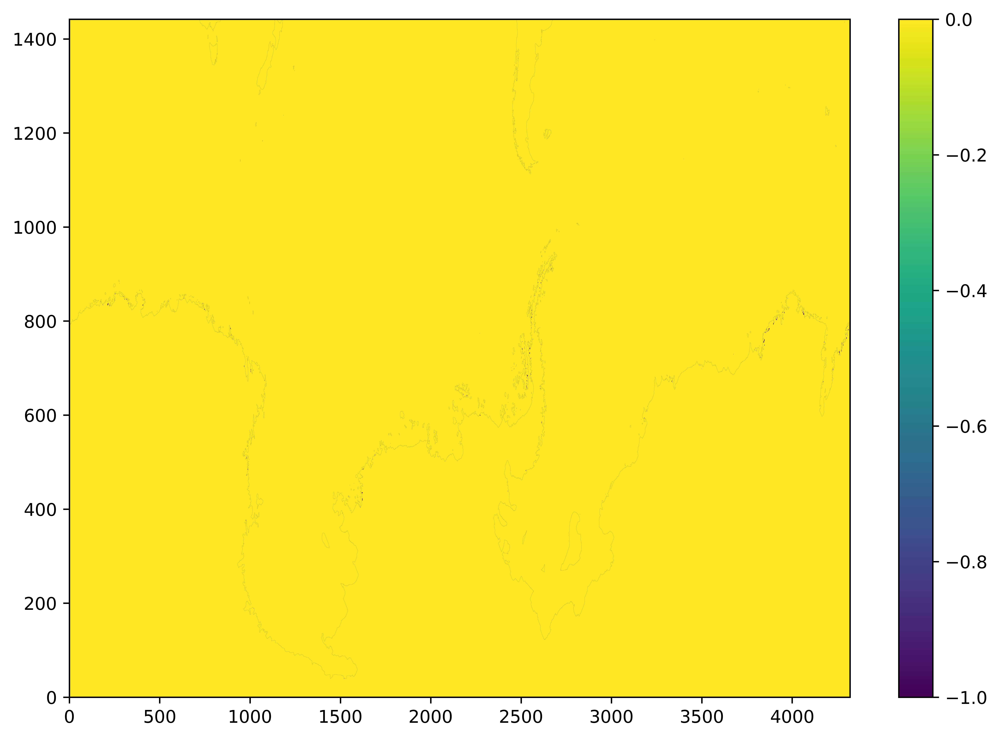

In [27]:
fig = plt.figure(figsize = (10,7),dpi = 1000)

plt.pcolormesh(filled_mask-small_mask)
plt.colorbar()
plt.contour(filled_mask,levels = [0.5],colors = 'k', linewidths = 0.02)
print(np.sum(filled_mask-small_mask))

# combine with mask for north so that we have a global version

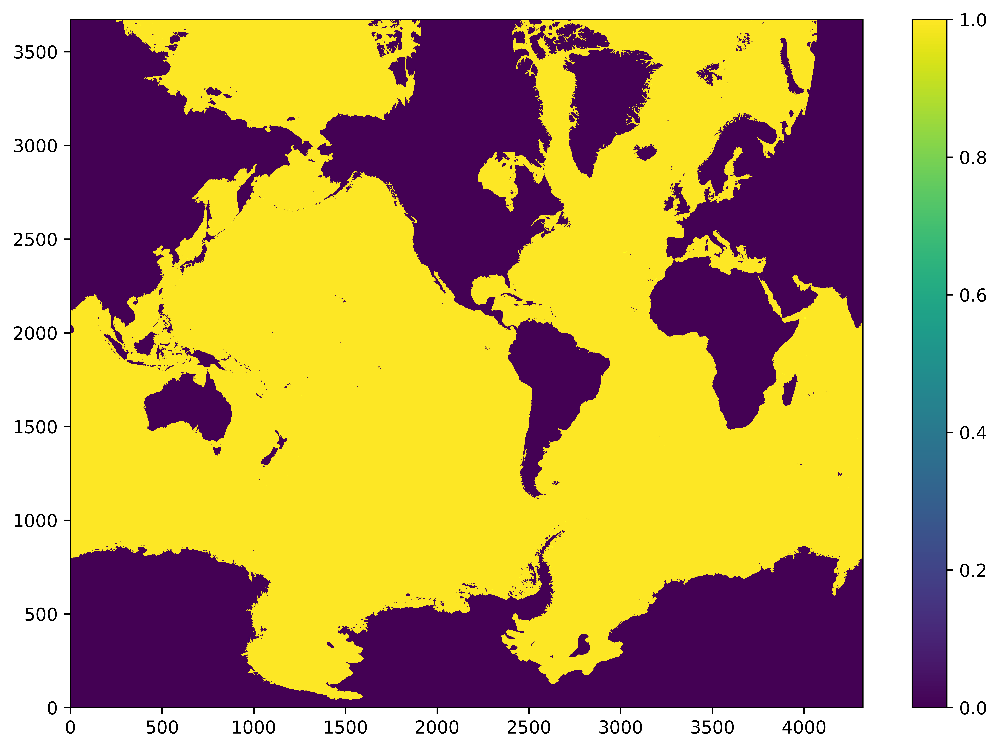

In [28]:
ocean_mask_deseas = ocean_mask.copy()
ocean_mask_deseas["mask"][:1442,:] = filled_mask[:,:] #replace with my connected ocean mask

fig = plt.figure(figsize = (10,7),dpi = 1000)

plt.pcolormesh(ocean_mask_deseas.mask)
plt.colorbar()


# NaN out topog

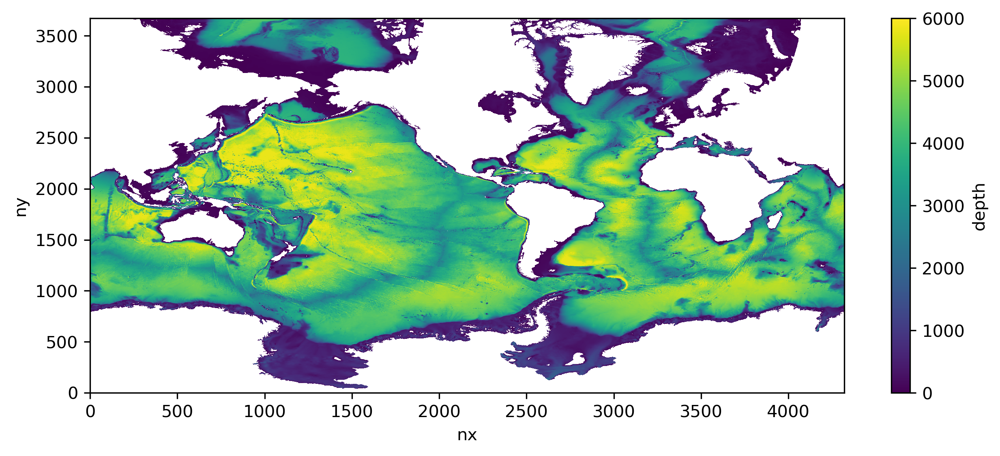

In [29]:
fig = plt.figure(figsize = (10,4),dpi = 300)

topog_depth_cutoff.depth.where(ocean_mask_deseas.mask>0).plot()

(0.0, 1442.0)

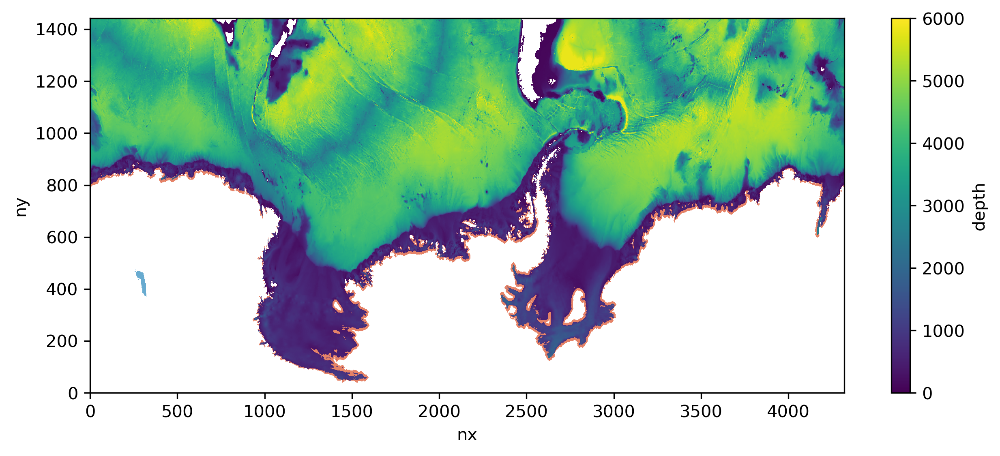

In [30]:
# plot topo and the "buffer zone"

fig = plt.figure(figsize = (10,4),dpi = 300)

topog_depth_cutoff.depth.where(ocean_mask_deseas.mask>0).plot()

test = (draft_ocean_mask-(topog_depth_cutoff.depth.where(ocean_mask_deseas.mask>0)*0+1).fillna(0)).sel(ny = slice(0,1000))
test.where(test !=0).plot(cmap = 'RdBu', vmin = -2, vmax = 2, add_colorbar = False)
plt.ylim(0,1442)

### save `ocean_mask.nc` and correctly NaN'd `topog.nc`

In [31]:
# open existing files for metadata
topogOG = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/topog_cropped.nc')
ocean_maskOG = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/ocean_mask_cropped.nc')
kmtOG = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/kmt_cropped.nc')


In [32]:
ds_topog_no_cavity = topog_depth_cutoff.copy()
ds_topog_no_cavity["depth"] = topog_depth_cutoff.depth.where(ocean_mask_deseas.mask>0)
ds_topog_no_cavity = ds_topog_no_cavity.rename({'lat':'geolat_t','lon':'geolon_t'})
ds_topog_no_cavity.attrs = dict(description="Charrassin 2025 depth regridded onto 8km grid, filled elsewhere with GEBCO 2024 data that was created with OM3 bathymetry pipeline by Angus. Generated with notebook https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/Generate-Charrassin-bathy.ipynb Then maximum depth 6000m applied and land (elevation > 0m) or GROUNDING LINE extended inland by 10 points applied as a mask in https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/process-topo.ipynb. Deseas applied manually.")
#ds_topog_no_cavity.depth.attrs = topogOG.depth.attrs
ds_topog_no_cavity

<xarray.Dataset> Size: 190MB
Dimensions:   (ny: 3672, nx: 4320)
Dimensions without coordinates: ny, nx
Data variables:
    depth     (ny, nx) float32 63MB nan nan nan nan nan ... nan nan nan nan nan
    geolat_t  (ny, nx) float32 63MB ...
    geolon_t  (ny, nx) float32 63MB ...
Attributes:
    description:  Charrassin 2025 depth regridded onto 8km grid, filled elsew...

In [33]:
enc = {
    "_FillValue": -1.e+30,
    # "zlib": True,
    # "shuffle": True,
    # "complevel": 1,
}
ds_topog_no_cavity.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km/topog_Charrassin_opencavity.nc", encoding={ "depth": enc})
                                                      

In [34]:
ds_ocean_mask_noshelf = ocean_mask_deseas.drop(["lat","lon"])
ds_ocean_mask_noshelf.attrs = dict(description="Charrassin 2025 depth regridded onto 8km grid, filled elsewhere with GEBCO 2024 data that was created with OM3 bathymetry pipeline by Angus. Generated with notebook https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/Generate-Charrassin-bathy.ipynb Then maximum depth 6000m applied and land (elevation > 0m) or GROUNDING LINE extended inland by 10 points applied as a mask in https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/process-topo.ipynb. Deseas applied")

ds_ocean_mask_noshelf.mask.attrs = ocean_maskOG.mask.attrs
ds_ocean_mask_noshelf

  ds_ocean_mask_noshelf = ocean_mask_deseas.drop(["lat","lon"])



<xarray.Dataset> Size: 127MB
Dimensions:  (ny: 3672, nx: 4320)
Dimensions without coordinates: ny, nx
Data variables:
    mask     (ny, nx) float64 127MB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
Attributes:
    description:  Charrassin 2025 depth regridded onto 8km grid, filled elsew...

In [35]:
ds_ocean_mask_noshelf.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km/ocean_mask_Charrassin_opencavity.nc")

# open ice sheet thickness and make file

Need `area` (actual area, not fraction) info on grid - ocean_hgrid is on super grid so not helpful - take from a very short trial run with cavities open but no ice shelf?? (**TODO**)

In [36]:
# FOR REFERENCE
# NEEDS AREA VARIABLE AND REMOVE LAT LON, AND UPDATE METADATA
ice_Charrassin = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/ice_thickness_Charrassin_regridded.nc')

# do sea ice mask (=no ice shelf versions)

(need a topog.nc with correct nan values)

In [15]:
#/g/data/x77/cy8964/mom6/input/input-8km/topog_cropped.nc

#need to copy metadata etc

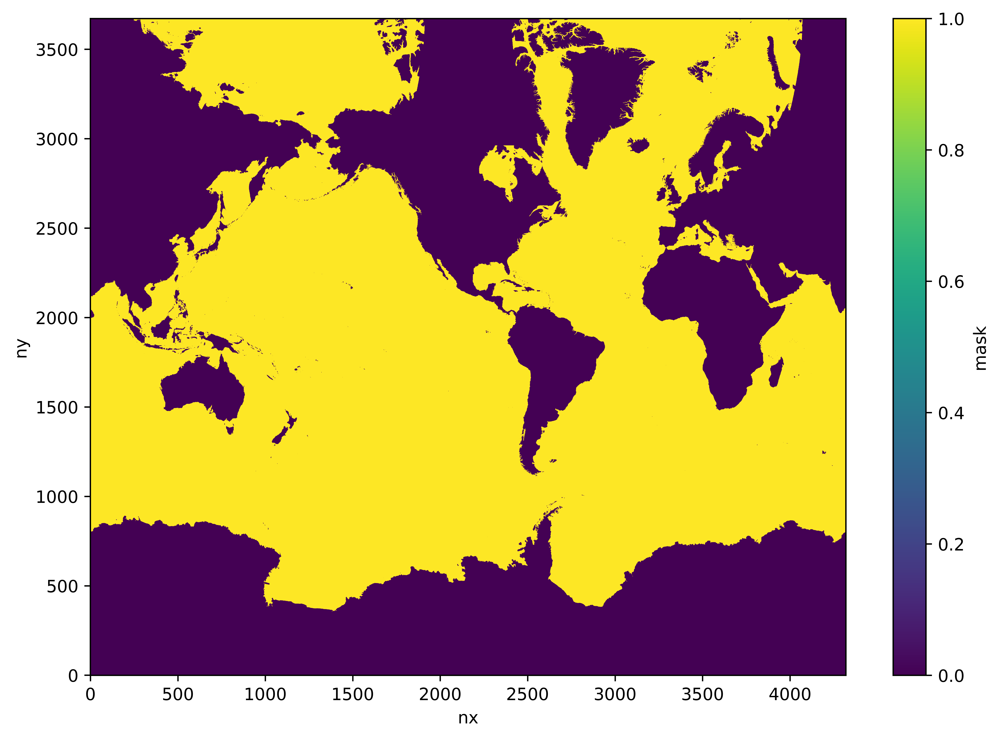

In [16]:
kmt_noIS = topog_depth_cutoff.copy()
kmt_noIS["mask"] = (kmt_noIS.depth.where(kmt_noIS.depth > 0)*0+1).fillna(0)
ice_mask = (ice_thick.thick.where(ice_thick.thick==0)*0+1).fillna(0)
kmt_noIS["mask"] = np.minimum(kmt_noIS["mask"],ice_mask)
kmt_noIS = kmt_noIS.drop_vars("depth")

ocean_mask_noshelf = kmt_noIS.copy()

kmt_noIS = kmt_noIS.rename({'lat':'geolat_t','lon':'geolon_t'})

fig = plt.figure(figsize = (10,7),dpi = 1000)
kmt_noIS.mask.plot()
plt.show()

topog_no_cavity = topog_depth_cutoff.depth.where(kmt_noIS.mask>0)

fig = plt.figure(figsize = (10,7),dpi = 1000)
topog_no_cavity.plot()

In [18]:
# open existing files for metadata
topogOG = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/topog_cropped.nc')
ocean_maskOG = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/ocean_mask_cropped.nc')
kmtOG = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/kmt_cropped.nc')


In [19]:
ds_topog_no_cavity = topog_depth_cutoff.copy()
ds_topog_no_cavity["depth"] = topog_depth_cutoff.depth.where(kmt_noIS.mask>0)
ds_topog_no_cavity = ds_topog_no_cavity.rename({'lat':'geolat_t','lon':'geolon_t'})
ds_topog_no_cavity.attrs = dict(description="Charrassin 2025 depth regridded onto 8km grid, filled elsewhere with GEBCO 2024 data that was created with OM3 bathymetry pipeline by Angus. Generated with notebook https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/Generate-Charrassin-bathy.ipynb Then maximum depth 6000m applied and land (elevation > 0m) or presence of ice sheet applied as a mask in https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/process-topo.ipynb")
#ds_topog_no_cavity.depth.attrs = topogOG.depth.attrs
ds_topog_no_cavity

<xarray.Dataset> Size: 190MB
Dimensions:   (ny: 3672, nx: 4320)
Dimensions without coordinates: ny, nx
Data variables:
    depth     (ny, nx) float32 63MB nan nan nan nan nan ... nan nan nan nan nan
    geolat_t  (ny, nx) float32 63MB ...
    geolon_t  (ny, nx) float32 63MB ...
Attributes:
    description:  Charrassin 2025 depth regridded onto 8km grid, filled elsew...

In [34]:
enc = {
    "_FillValue": -1.e+30,
    # "zlib": True,
    # "shuffle": True,
    # "complevel": 1,
}
#ds_topog_no_cavity.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km/topog_Charrassin_nocavity.nc", encoding={ "depth": enc})
                                                      

In [20]:
ds_ocean_mask_noshelf = ocean_mask_noshelf.drop(["lat","lon"])
ds_ocean_mask_noshelf.attrs = dict(description="Charrassin 2025 depth regridded onto 8km grid, filled elsewhere with GEBCO 2024 data that was created with OM3 bathymetry pipeline by Angus. Generated with notebook https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/Generate-Charrassin-bathy.ipynb Then maximum depth 6000m applied and land (elevation > 0m) or presence of ice sheet applied as a mask in https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/process-topo.ipynb.")

ds_ocean_mask_noshelf.mask.attrs = ocean_maskOG.mask.attrs
ds_ocean_mask_noshelf

  ds_ocean_mask_noshelf = ocean_mask_noshelf.drop(["lat","lon"])



<xarray.Dataset> Size: 63MB
Dimensions:  (ny: 3672, nx: 4320)
Dimensions without coordinates: ny, nx
Data variables:
    mask     (ny, nx) float32 63MB 0.0 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0 0.0 0.0
Attributes:
    description:  Charrassin 2025 depth regridded onto 8km grid, filled elsew...

In [46]:
#ds_ocean_mask_noshelf.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km/ocean_mask_Charrassin_nocavity.nc")

In [50]:
ds_kmt_noshelf = ds_ocean_mask_noshelf.rename_vars({"mask":"kmt"})
#ds_kmt_noshelf.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km/kmt_Charrassin_nocavity.nc")

#kmtOG#.mask#.plot()

# Find inland seas/unconnected cells (for sea ice mask)

In [21]:
small_mask = ds_ocean_mask_noshelf.mask.isel(ny = np.arange(1442))

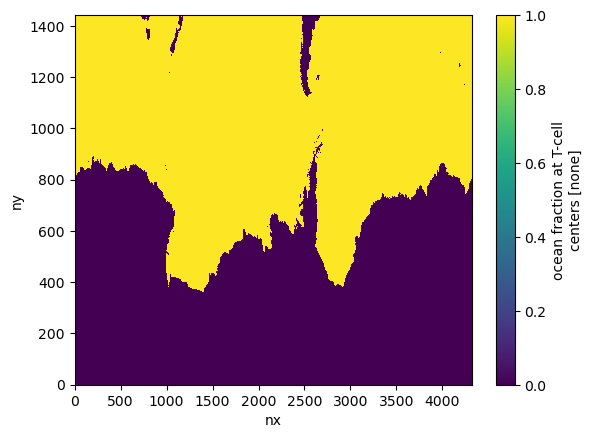

In [22]:
small_mask.plot()

In [43]:
#start at left and right side of domain
print(small_mask[-1,0])
print(small_mask[-1,-1])

working_out_mask = np.zeros_like(small_mask)
working_out_mask[-1,0] = 1
working_out_mask[-1,1] = 1
working_out_mask[-2,0] = 1
working_out_mask[-2,1] = 1

filled_mask = np.zeros_like(small_mask)
filled_mask[-1,0] = 1
filled_mask[-1,1] = 1
filled_mask[-2,0] = 1
filled_mask[-2,1] = 1

#also start a line in the middle to speed it up
filled_mask[1050,:] = 1
working_out_mask[1050,:] = 1
#check this line is all ocean (it is)
print(np.min(small_mask[1050,:]))

#reset counter
sum_ocean = 0

for i in np.arange(25):
    print('iteration ',i)
    # work north-east, and north-west, north of ocean line
    # then work south-east, and south-west, south of ocean line
    
    for jjs in np.arange(1050,1441):
        for iis in np.arange(1,4319):
            if working_out_mask[jjs,iis] == 0:
                # if neighbouring existing is filled mask
                if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1) or (filled_mask[jjs,iis+1] ==1):
                    filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                    #print('yooo')
                # update to say it has been checked
                    working_out_mask[jjs,iis] = 1
        iis = 0
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis+1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
        iis = 4319
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
        
    for jjs in np.arange(1050,1441):
        for iis in np.arange(4318,0,-1):
            if working_out_mask[jjs,iis] == 0:
                # if neighbouring existing is filled mask
                if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1) or (filled_mask[jjs,iis+1] ==1):
                    filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                    #print('yooo')
                # update to say it has been checked
                    working_out_mask[jjs,iis] = 1
        iis = 0
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis+1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
        iis = 4319
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
    # now do top
    jjs = 1441
    for iis in np.arange(1,4319):
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1)  or (filled_mask[jjs,iis-1] ==1) or (filled_mask[jjs,iis+1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
    iis = 0
    if working_out_mask[jjs,iis] == 0:
        # if neighbouring existing is filled mask
        if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis+1] ==1):
            filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
            #print('yooo')
        # update to say it has been checked
            working_out_mask[jjs,iis] = 1
    iis = 4319
    if working_out_mask[jjs,iis] == 0:
        # if neighbouring existing is filled mask
        if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1):
            filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
            #print('yooo')
        # update to say it has been checked
            working_out_mask[jjs,iis] = 1
            

    for jjs in np.arange(1049,300,-1):
        for iis in np.arange(1,4319):
            if working_out_mask[jjs,iis] == 0:
                # if neighbouring existing is filled mask
                if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1) or (filled_mask[jjs,iis+1] ==1):
                    filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                    #print('yooo')
                # update to say it has been checked
                    working_out_mask[jjs,iis] = 1
        iis = 0
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis+1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
        iis = 4319
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
    for jjs in np.arange(1049,300,-1):
        for iis in np.arange(4318,0,-1):
            if working_out_mask[jjs,iis] == 0:
                # if neighbouring existing is filled mask
                if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1) or (filled_mask[jjs,iis+1] ==1):
                    filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                    #print('yooo')
                # update to say it has been checked
                    working_out_mask[jjs,iis] = 1
        iis = 0
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis+1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
        iis = 4319
        if working_out_mask[jjs,iis] == 0:
            # if neighbouring existing is filled mask
            if (filled_mask[jjs-1,iis] ==1) or (filled_mask[jjs+1,iis] ==1) or (filled_mask[jjs,iis-1] ==1):
                filled_mask[jjs,iis]= small_mask[jjs,iis] #0 is land 1 is ocean
                #print('yooo')
            # update to say it has been checked
                working_out_mask[jjs,iis] = 1
                    
    print(np.sum(working_out_mask)) # if this number is constant then have converged (no more connected cells)

    if (np.sum(working_out_mask) == sum_ocean):
        print('convergence achieved yay')
        break
    else:
        sum_ocean = np.sum(working_out_mask)

<xarray.DataArray 'mask' ()> Size: 4B
array(1., dtype=float32)
Attributes:
    standard_name:  ocean fraction at T-cell centers
    units:          none
<xarray.DataArray 'mask' ()> Size: 4B
array(1., dtype=float32)
Attributes:
    standard_name:  ocean fraction at T-cell centers
    units:          none
<xarray.DataArray 'mask' ()> Size: 8B
array(1.)
iteration  0
3337878.0
iteration  1
3339338.0
iteration  2
3339890.0
iteration  3
3340218.0
iteration  4
3340369.0
iteration  5
3340486.0
iteration  6
3340583.0
iteration  7
3340660.0
iteration  8
3340712.0
iteration  9
3340728.0
iteration  10
3340738.0
iteration  11
3340745.0
iteration  12
3340762.0
iteration  13
3340771.0
iteration  14
3340778.0
iteration  15
3340778.0
convergence achieved yay


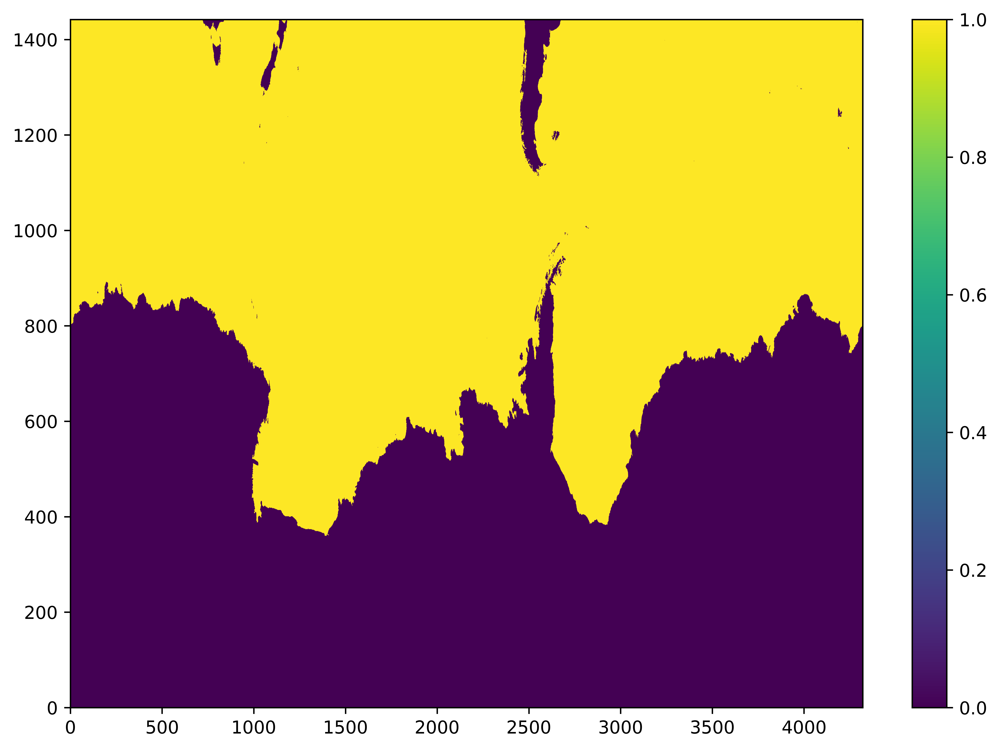

In [44]:
fig = plt.figure(figsize = (10,7),dpi = 1000)

plt.pcolormesh(filled_mask)
plt.colorbar()

<xarray.DataArray 'mask' ()> Size: 4B
array(-187., dtype=float32)


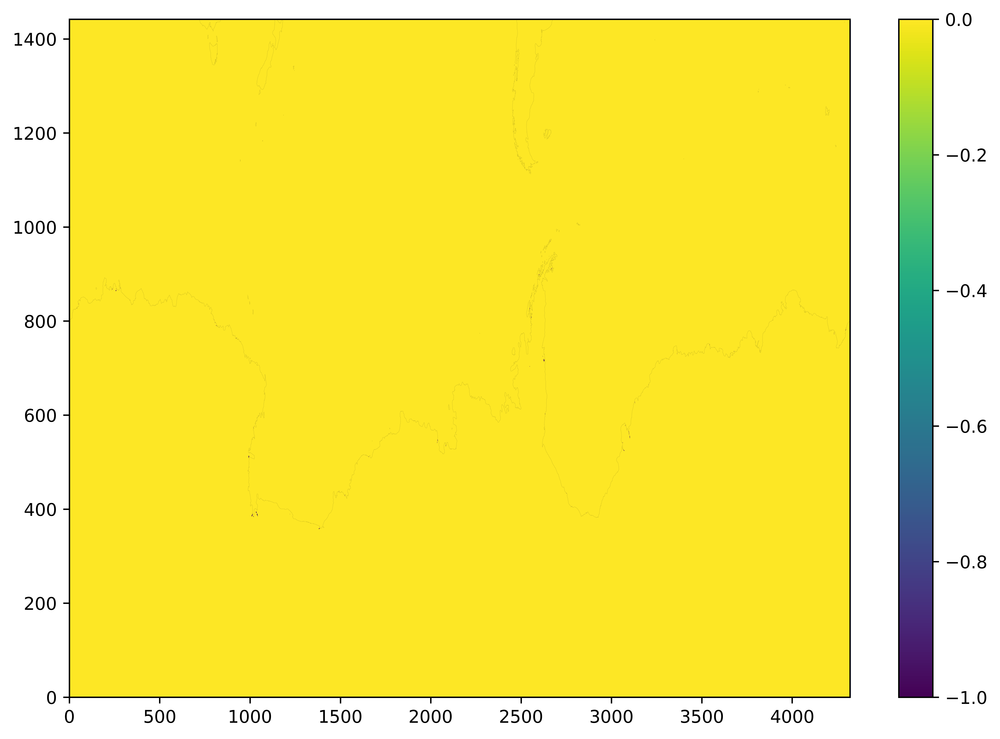

In [45]:
fig = plt.figure(figsize = (10,7),dpi = 1000)

plt.pcolormesh(filled_mask-small_mask)
plt.colorbar()
plt.contour(filled_mask,levels = [0.5],colors = 'k', linewidths = 0.02)
print(np.sum(filled_mask-small_mask))

(0.0, 50.0)

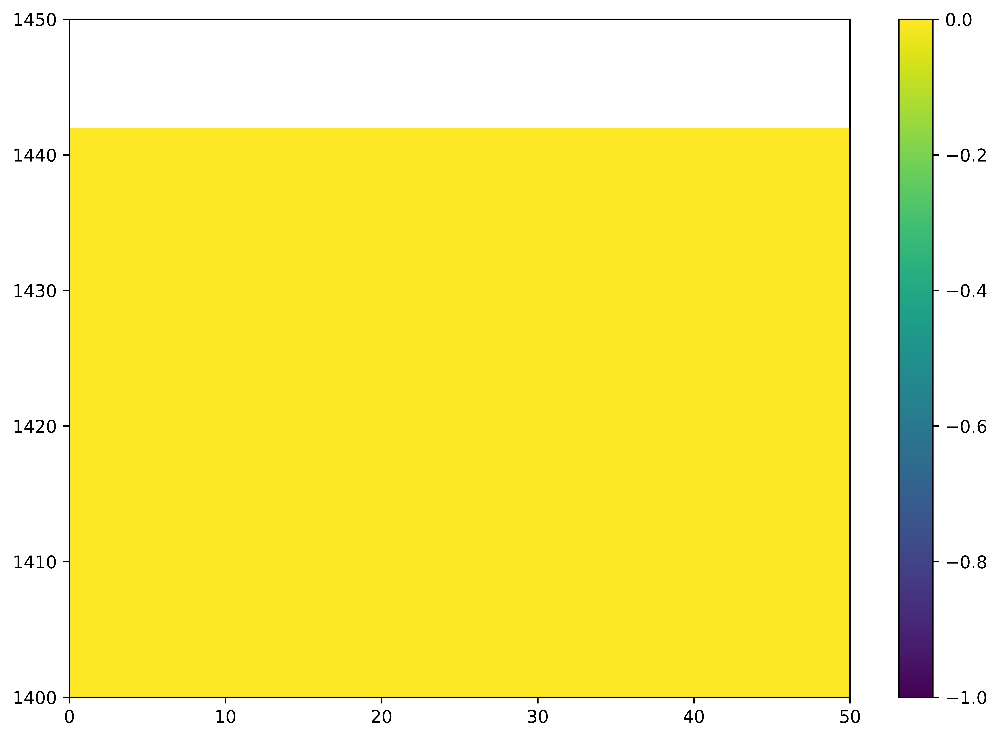

In [46]:
#check eastern and northern boundary that i did iteration ok

fig = plt.figure(figsize = (10,7),dpi = 1000)

plt.pcolormesh(filled_mask-small_mask)
plt.colorbar()
plt.contour(filled_mask,levels = [0.5],colors = 'k', linewidths = 0.02)
plt.ylim(1400,1450)
plt.xlim(0,50)

1.0


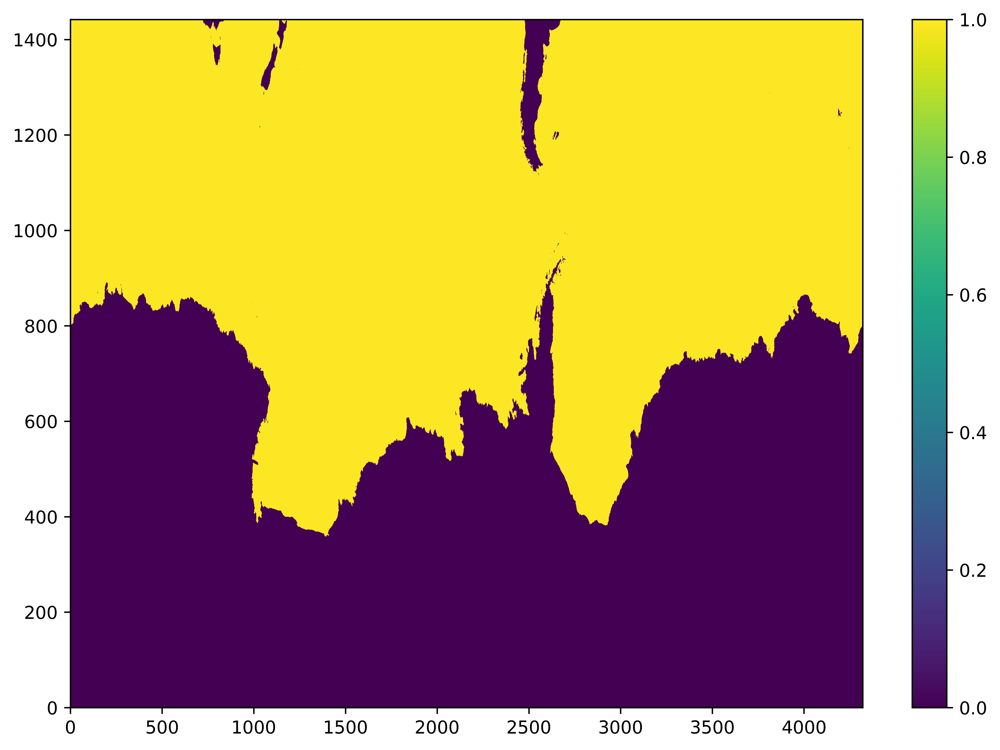

In [47]:
fig = plt.figure(figsize = (10,7),dpi = 1000)

plt.pcolormesh(working_out_mask)
plt.colorbar()

print(np.max(filled_mask))

# save manual-deseas output

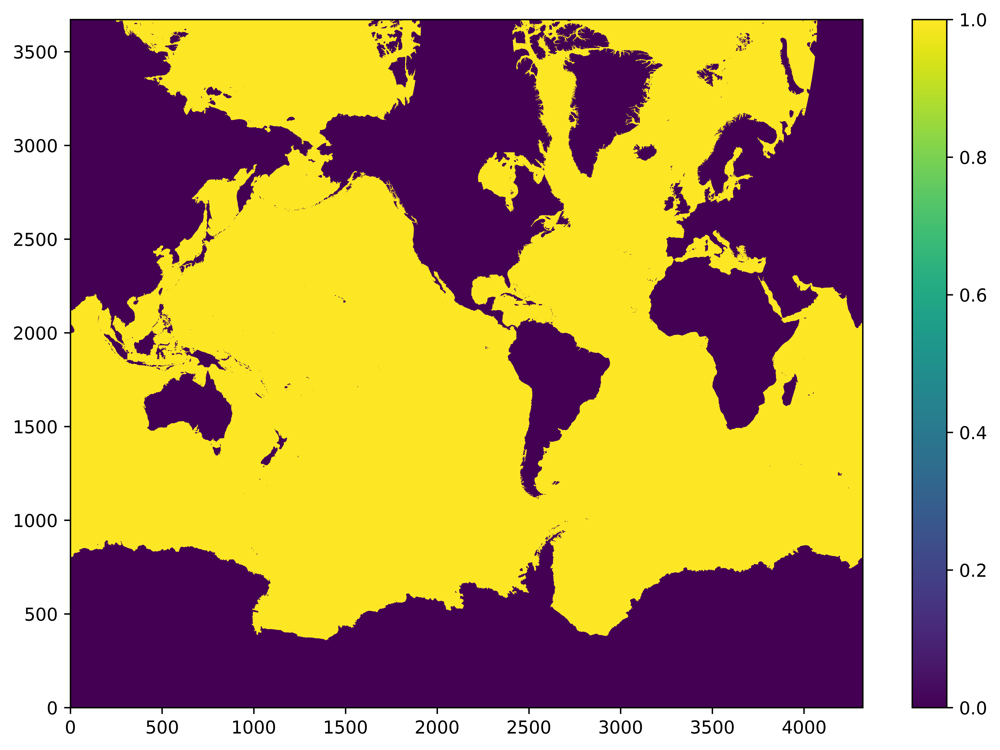

In [48]:
kmt_noIS_deseas = kmt_noIS.copy()
kmt_noIS_deseas["mask"][:1442,:] = filled_mask[:,:]

fig = plt.figure(figsize = (10,7),dpi = 1000)

plt.pcolormesh(kmt_noIS_deseas.mask)
plt.colorbar()



In [55]:
ds_topog_no_cavity = topog_depth_cutoff.copy()
ds_topog_no_cavity["depth"] = topog_depth_cutoff.depth.where(kmt_noIS_deseas.mask>0)

#add minimum 10 metre depth to masked version !!HACK - not good with ice shelves (or at least check)
ds_topog_no_cavity["depth"] = xr.where(ds_topog_no_cavity["depth"]<10.43281,10.43281,ds_topog_no_cavity["depth"])

ds_topog_no_cavity = ds_topog_no_cavity.rename({'lat':'geolat_t','lon':'geolon_t'})
ds_topog_no_cavity.attrs = dict(description="Charrassin 2025 depth regridded onto 8km grid, filled elsewhere with GEBCO 2024 data that was created with OM3 bathymetry pipeline by Angus. Generated with notebook https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/Generate-Charrassin-bathy.ipynb Then maximum depth 6000m applied and land (elevation > 0m) or presence of ice sheet applied as a mask in https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/process-topo.ipynb. Then, remove internal seas manually and set minimum ocean depth to 10.43281.")
#ds_topog_no_cavity.depth.attrs = topogOG.depth.attrs
ds_topog_no_cavity

<xarray.Dataset> Size: 190MB
Dimensions:   (ny: 3672, nx: 4320)
Dimensions without coordinates: ny, nx
Data variables:
    depth     (ny, nx) float32 63MB nan nan nan nan nan ... nan nan nan nan nan
    geolat_t  (ny, nx) float32 63MB ...
    geolon_t  (ny, nx) float32 63MB ...
Attributes:
    description:  Charrassin 2025 depth regridded onto 8km grid, filled elsew...

(0.0, 1442.0)

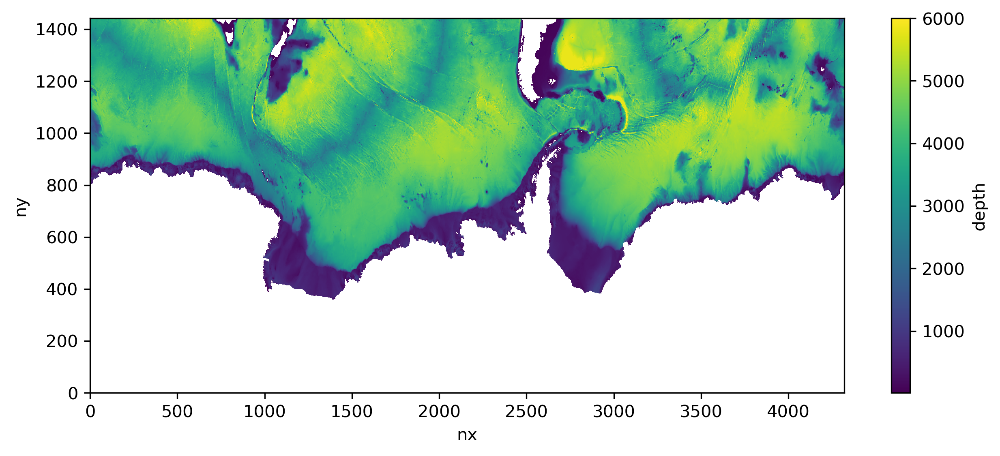

In [66]:
fig = plt.figure(figsize = (10,4),dpi = 300)
ds_topog_no_cavity.depth.plot()
plt.ylim(0,1442)

In [57]:
enc = {
    "_FillValue": -1.e+30,
    # "zlib": True,
    # "shuffle": True,
    # "complevel": 1,
}
ds_topog_no_cavity.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km/topog_Charrassin_nocavity.nc", encoding={ "depth": enc})


In [59]:
ocean_mask_noshelf = kmt_noIS.copy()
ds_ocean_mask_noshelf = ocean_mask_noshelf.drop(["geolat_t","geolon_t"])
ds_ocean_mask_noshelf.attrs = dict(description="Charrassin 2025 depth regridded onto 8km grid, filled elsewhere with GEBCO 2024 data that was created with OM3 bathymetry pipeline by Angus. Generated with notebook https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/Generate-Charrassin-bathy.ipynb Then maximum depth 6000m applied and land (elevation > 0m) or presence of ice sheet applied as a mask in https://github.com/claireyung/mom6-panAn-iceshelf-tools/blob/add_charrassin_bathy/generate-draft/process-topo.ipynb. Then, remove internal seas manually and set minimum ocean depth to 10m.")

ds_ocean_mask_noshelf.mask.attrs = ocean_maskOG.mask.attrs
ds_ocean_mask_noshelf.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km/ocean_mask_Charrassin_nocavity.nc")

  ds_ocean_mask_noshelf = ocean_mask_noshelf.drop(["geolat_t","geolon_t"])



In [60]:
ds_kmt_noshelf = ds_ocean_mask_noshelf.rename_vars({"mask":"kmt"})
ds_kmt_noshelf.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km/kmt_Charrassin_nocavity.nc")

#kmtOG#.mask#.plot()

# Next steps to start a run with new topo (same 8km grid as before)

Copy config dir 
```
cp -r 8km_jra_ryf_obc2-sapphirerapid 8km_jra_ryf_obc2-sapphirerapid-Charrassin
cd 8km_jra_ryf_obc2-sapphirerapid-Charrassin
ls
module use /g/data/vk83/modules
module load payu
payu checkout -b 8km_jra_ryf_obc2-sapphirerapid-Charrassin
```

Now crop files (`cd /g/data/x77/cy8964/mom6/input/input-8km`)

```
ncks -d ny,0,1441 topog_Charrassin_nocavity.nc topog_Charrassin_nocavity_cropped.nc
ncks -d ny,0,1441 ocean_mask_Charrassin_nocavity.nc ocean_mask_Charrassin_nocavity_cropped.nc
ncks -d ny,0,1441 kmt_Charrassin_nocavity.nc kmt_Charrassin_nocavity_cropped.nc
```

and make rof, mask files etc (`cd /home/156/cy8964/model-tools/make_OM3_8k_topo`)

```
# Copyright 2025 ACCESS-NRI and contributors. See the top-level COPYRIGHT file for details.
# SPDX-License-Identifier: Apache-2.0

#PBS -q normal
#PBS -l walltime=4:00:00,mem=10GB
#PBS -l wd
#PBS -l storage=gdata/hh5+gdata/ik11+gdata/tm70+gdata/vk83+gdata/x77

# Input files - Using the environment variables passed via -v
INPUT_HGRID=$INPUT_HGRID
INPUT_VGRID=$INPUT_VGRID
INPUT_GBCO=$INPUT_GBCO
# Minimum allowed y-size for a cell (in m)
CUTOFF_VALUE=6000
# Output filenames
ESMF_MESH_FILE='access-om3-8km-ESMFmesh.nc'
ESMF_NO_MASK_MESH_FILE='access-om3-8km-nomask-ESMFmesh.nc'
ROF_WEIGHTS_FILE='access-om3-8km-rof-remap-weights.nc'

# Build bathymetry-tools
./build.sh

module purge
module use /g/data/hh5/public/modules
module load conda/analysis3
module load nco

set -x #print commands to e file
set -e #exit on error

python3 /home/156/cy8964/model-tools/om3-scripts/mesh_generation/generate_mesh.py --grid-type=mom --grid-filename=/g/data/x77/cy8964/mom6/input/input-8km/ocean_hgrid_cropped.nc --mesh-filename=/g/data/x77/cy8964/mom6/input/input-8km/access-om3-8km-ESMFmesh_Charrassin_nocavity_cropped.nc --mask-filename=/g/data/x77/cy8964/mom6/input/input-8km/ocean_mask_Charrassin_nocavity_cropped.nc --wrap-lons

python3 /home/156/cy8964/model-tools/om3-scripts/mesh_generation/generate_mesh.py --grid-type=mom --grid-filename=/g/data/x77/cy8964/mom6/input/input-8km/ocean_hgrid_cropped.nc --mesh-filename=/g/data/x77/cy8964/mom6/input/input-8km/access-om3-8km-nomask-ESMFmesh_Charrassin_nocavity_cropped.nc --wrap-lons

python3 ./om3-scripts/mesh_generation/generate_rof_weights.py --mesh_filename=/g/data/x77/cy8964/mom6/input/input-8km/access-om3-8km-ESMFmesh_Charrassin_nocavity_cropped.nc --weights_filename=/g/data/x77/cy8964/mom6/input/input-8km/access-om3-8km-rof-remap-weights_Charrassin_nocavity_cropped.nc

```

Added files and renamed netcdf names to `config.yaml`, `datm_in`, `ice_in`, `drof_in`, `nuopc.runconfig`, `MOM_override`

Do the same for `opencavity` files
```
/g/data/x77/cy8964/mom6/input/input-8km/topog_Charrassin_opencavity.nc
/g/data/x77/cy8964/mom6/input/input-8km/ocean_mask_Charrassin_opencavity.nc

ncks -d ny,0,1441 topog_Charrassin_opencavity.nc topog_Charrassin_opencavity_cropped.nc
ncks -d ny,0,1441 ocean_mask_Charrassin_opencavity.nc ocean_mask_Charrassin_opencavity_cropped.nc
```

make meshes 
```
# Copyright 2025 ACCESS-NRI and contributors. See the top-level COPYRIGHT file for details.
# SPDX-License-Identifier: Apache-2.0

#PBS -q normal
#PBS -l walltime=4:00:00,mem=10GB
#PBS -l wd
#PBS -l storage=gdata/hh5+gdata/ik11+gdata/tm70+gdata/vk83+gdata/x77

# Input files - Using the environment variables passed via -v
INPUT_HGRID=$INPUT_HGRID
INPUT_VGRID=$INPUT_VGRID
INPUT_GBCO=$INPUT_GBCO

# Build bathymetry-tools
./build.sh

module purge
module use /g/data/hh5/public/modules
module load conda/analysis3
module load nco

set -x #print commands to e file
set -e #exit on error

python3 /home/156/cy8964/model-tools/om3-scripts/mesh_generation/generate_mesh.py --grid-type=mom --grid-filename=/g/data/x77/cy8964/mom6/input/input-8km/ocean_hgrid_cropped.nc --mesh-filename=/g/data/x77/cy8964/mom6/input/input-8km/access-om3-8km-ESMFmesh_Charrassin_opencavity_cropped.nc --mask-filename=/g/data/x77/cy8964/mom6/input/input-8km/ocean_mask_Charrassin_opencavity_cropped.nc --wrap-lons

```


# Ran without ice but with open cavity to get area files 

config_dir: `8km_jra_ryf_obc2-cascadelake-Charrassin-newparams-rerun-opencavity`

```
ncks -d ny,0,1441 ice_thickness_Charrassin_regridded.nc ice_thickness_Charrassin_regridded_cropped.nc
```
copied ocean_geometry to get area: `/g/data/x77/cy8964/mom6/input/input-8km/ocean_geometry_opencavity_noice.nc`

In [4]:
ice_Charrassin = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/ice_thickness_Charrassin_regridded_cropped.nc')
topog = xr.open_dataset("/g/data/x77/cy8964/mom6/input/input-8km/topog_Charrassin_opencavity_cropped.nc")


In [5]:
(topog.depth.where(topog.depth<1)*0+1).sum().values

array(176., dtype=float32)

In [6]:
ocean_geometry = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km/ocean_geometry_opencavity_noice.nc')


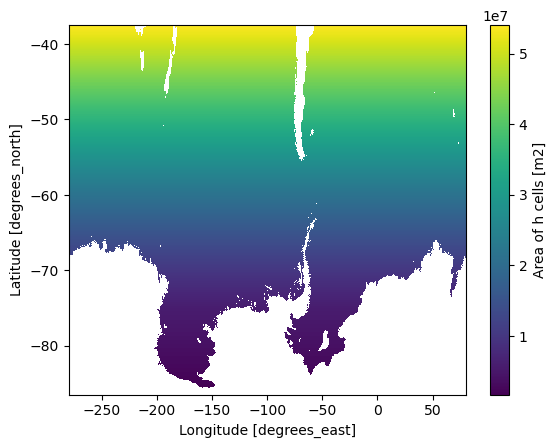

In [7]:
ocean_geometry.Ah.rename({'lath':'ny','lonh':'nx'}).where(topog.depth>0).plot()

In [9]:
enc_TS = {
    "_FillValue": -1.e-20}
#panan01_IC_for_8km.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km/ACCESS-OM2_IC_bfilled.nc", encoding={"temp": enc_TS, "salt": enc_TS})


In [10]:
ice_Charrassin_with_area = ice_Charrassin.copy().drop_vars(["lat","lon"])
ice_Charrassin_with_area["area"] = ocean_geometry.Ah.rename({'lath':'ny','lonh':'nx'}).where(topog.depth>0).where(ice_Charrassin.thick>0).fillna(0)
ice_Charrassin_with_area.area.attrs = dict({"description":"Genereated by running model without ice sheet plus mom6-panAn-iceshelf-tools/generate-draft/process-topo.ipynb"})
ice_Charrassin_with_area.attrs["description"] = ice_Charrassin_with_area.attrs["description"] + ". Area added afterwards by running model without ice sheet"

ice_Charrassin_with_area
ice_Charrassin_with_area.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km/ice_thickness_Charrassin_regridded_cropped_add_area.nc",
                                  encoding={"thick":enc_TS,"area":enc_TS})


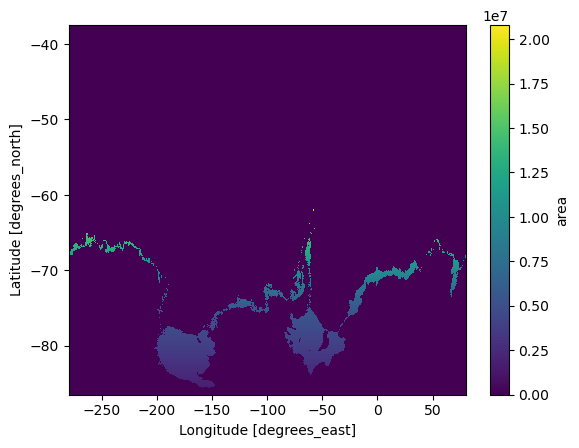

In [16]:
ice_Charrassin_with_area.area.plot()

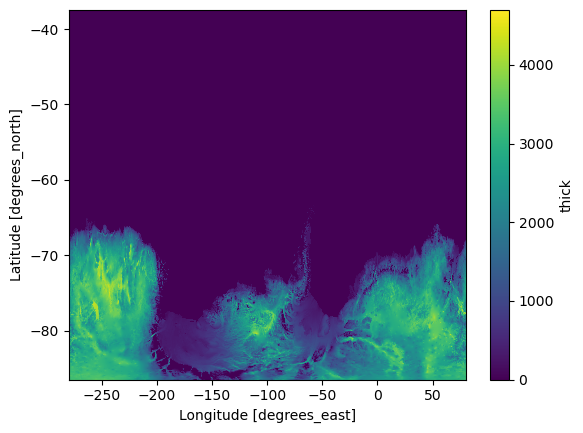

In [17]:
ice_Charrassin_with_area.thick.plot()

# Is the fact that there aren't NaNs gonna be a problem?

# Fix metadata in topog.nc

```
float depth(ny, nx) ;
		depth:long_name = "depth" ;
		depth:units = "m" ;
		depth:grid_type = "C" ;
		depth:lakes_removed = "yes" ;
		depth:minimum_depth = 10.43281f ;
		depth:minimum_levels = 7 ;
		depth:maximum_depth = 5808.657f ;
		depth:nonadvective_cells_removed = "" ;
		depth:_FillValue = -1.e+30f ;
	float sea_area_fraction(ny, nx) ;
		sea_area_fraction:_FillValue = -1.e+30f ;
	float geolon_t(ny, nx) ;
		geolon_t:long_name = "tracer longitude" ;
		geolon_t:units = "degrees_E" ;
	float geolat_t(ny, nx) ;
		geolat_t:long_name = "tracer latitude" ;
		geolat_t:units = "degrees_N" ;

In [5]:
enc_TS = {
    "_FillValue": -1.e-20}


In [4]:
topog = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km-SIS2/topog_Charrassin_opencavity_cropped_mindepth5.nc')
topog.depth.attrs= {'long_name':"depth",
                    'units':'m',
                    'grid_type':'C'}
topog.geolon_t.attrs = {'long_name':'tracer longitude',
                     'units':'degrees_E'}
topog.geolat_t.attrs = {'long_name':'tracer latitude',
                     'units':'degrees_N'}
topog.expand_dims(ntiles = 1

<xarray.Dataset> Size: 75MB
Dimensions:   (ny: 1442, nx: 4320)
Dimensions without coordinates: ny, nx
Data variables:
    depth     (ny, nx) float32 25MB ...
    geolat_t  (ny, nx) float32 25MB ...
    geolon_t  (ny, nx) float32 25MB ...
Attributes:
    description:  Charrassin 2025 depth regridded onto 8km grid, filled elsew...
    history:      Sun Jun 15 09:11:39 2025: /g/data/xp65/public/apps/med_cond...
    NCO:          netCDF Operators version 5.3.3 (Homepage = http://nco.sf.ne...

In [6]:
topog.to_netcdf("/scratch/x77/cy8964/FRE-NCtools/src/topog_Charrassin_opencavity_cropped_mindepth5.nc",
                                  encoding={"depth":enc_TS})


# Make topog only include non-grounded ice
Use layer mode intial conditions to find ocean thickness

In [3]:
topog = xr.open_dataset('/g/data/x77/cy8964/mom6/input/input-8km-SIS2/topog_Charrassin_opencavity_cropped_mindepth5.nc')


In [4]:
#open h from layer mode initialisation
IC = xr.open_mfdataset('/scratch/x77/cy8964/mom6/work/mom6-panan-2-testing/MOM_IC_2.nc',parallel = True, decode_times = False)


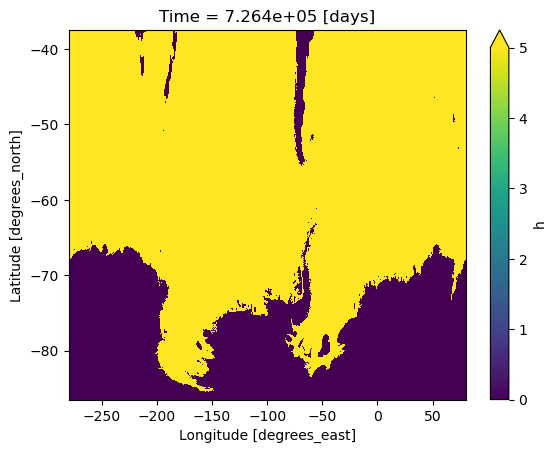

In [5]:
IC.h.sum('Layer').plot(vmax = 5)

In [6]:
ocean_thickness_IC = IC.h.isel(Time = 0).sum('Layer').rename({'lath':'lat','lonh':'lon'})
ocean_thickness_IC = xr.merge([ocean_thickness_IC]).rename({'h':'ocean_thick'})
ocean_thickness_IC.ocean_thick.attrs = {'long_name':'Ocean column depth'}
ocean_thickness_IC.attrs = {'description': 'Ocean column thickness generated from initial conditions file MOM_IC_2.nc by summing h in the vertical. Taken from a 1/12th deg panan MOM6-SIS2 layer simulation with Charrassin bathymetry and ice shelf thickness https://github.com/claireyung/mom6-panan/tree/5a0ddaaa9221e17df39a7663a470e7967a5caf17'}

In [7]:
ocean_thickness_IC

<xarray.Dataset> Size: 50MB
Dimensions:      (lat: 1442, lon: 4320)
Coordinates:
  * lat          (lat) float64 12kB -86.49 -86.47 -86.45 ... -37.63 -37.56 -37.5
  * lon          (lon) float64 35kB -280.0 -279.9 -279.8 ... 79.79 79.88 79.96
    Time         float64 8B 7.264e+05
Data variables:
    ocean_thick  (lat, lon) float64 50MB dask.array<chunksize=(145, 432), meta=np.ndarray>
Attributes:
    description:  Ocean column thickness generated from initial conditions fi...

In [18]:
# ocean_thickness_IC.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km-SIS2/ocean_thickness_iceshelf_Charrassin_opencavity_from_IC.nc",
#                                   encoding={"ocean_thick":enc_TS})


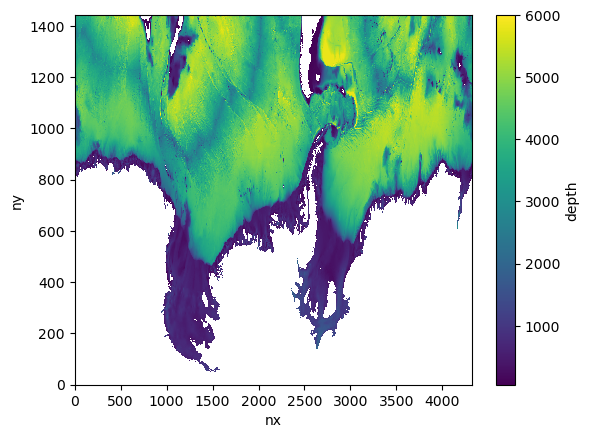

In [10]:
topog_noGL = topog.copy()
topog_noGL_mask = topog_noGL.depth*0+IC.h.isel(Time=0).sum('Layer').values
topog_noGL['depth'] = topog_noGL.depth.where(topog_noGL_mask>50)
topog_noGL.depth.plot()

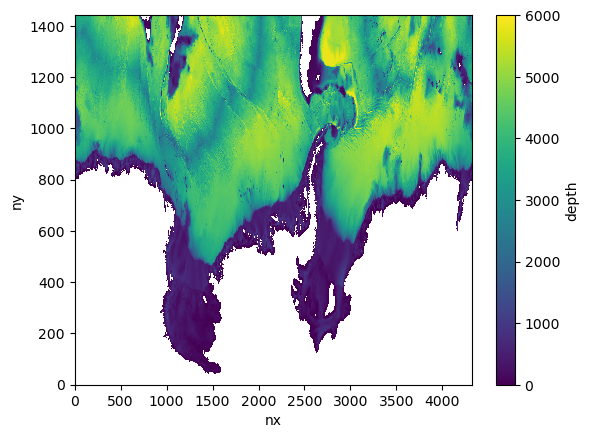

In [11]:
topog_noGL_mask.plot()

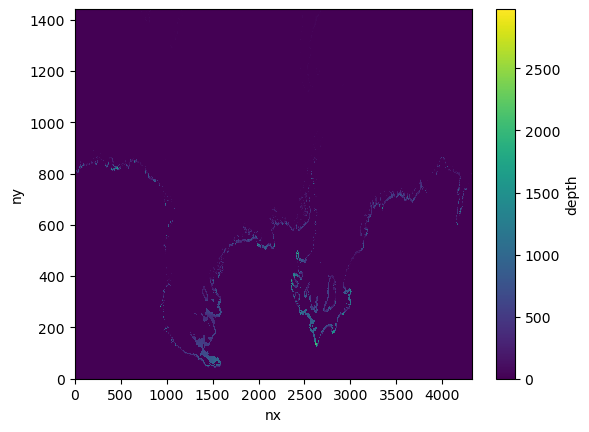

In [12]:
(topog.depth.fillna(0)-topog_noGL.depth.fillna(0)).plot()

In [14]:
enc_TS = {
    "_FillValue": -1.e-20}


In [15]:
topog_noGL

<xarray.Dataset> Size: 75MB
Dimensions:   (ny: 1442, nx: 4320)
Dimensions without coordinates: ny, nx
Data variables:
    depth     (ny, nx) float32 25MB nan nan nan ... 2.515e+03 2.73e+03 2.744e+03
    geolat_t  (ny, nx) float32 25MB ...
    geolon_t  (ny, nx) float32 25MB ...
Attributes:
    description:  Charrassin 2025 depth regridded onto 8km grid, filled elsew...
    history:      Sun Jun 15 09:11:39 2025: /g/data/xp65/public/apps/med_cond...
    NCO:          netCDF Operators version 5.3.3 (Homepage = http://nco.sf.ne...

In [16]:
topog_noGL.to_netcdf("/g/data/x77/cy8964/mom6/input/input-8km-SIS2/topog_Charrassin_opencavity_cropped_mindepth5_NOGL50m.nc",
                                  encoding={"depth":enc_TS})
